In [1]:
import requests
import pandas as pd
from bs4 import BeautifulSoup

# Step 1: Access the API
url = "http://aklc.hydrotel.co.nz:8080/KiWIS/KiWIS?service=kisters&type=queryServices&request=getTimeseriesValues&datasource=1&format=html&ts_id=4080&from=2006-01-01"
page = requests.get(url)

soup = BeautifulSoup(page.text, 'lxml')

In [2]:
soup

<html><head><style type="text/css">tr.head {
		background-color: #FFFFFF;
		font-weight: bold;
		}
tr.even {background-color: #EEEEEE}
tr.odd {background-color: #FFFFFF}</style></head><body style="font-family: arial"><table><tr class="head"><td>ts_id</td><td>4080</td></tr><tr class="head"><td>rows</td><td>161977</td></tr><tr class="head"><td>----------------------</td><td>--------------------------------</td></tr><tr class="head"><td>Timestamp</td><td>Value</td></tr><tr class="even"><td>2006-01-01T00:00:00.000+12:00</td><td>23.3</td></tr><tr></tr><tr class="odd"><td>2006-01-01T01:00:00.000+12:00</td><td>13.2</td></tr><tr></tr><tr class="even"><td>2006-01-01T02:00:00.000+12:00</td><td>18.5</td></tr><tr></tr><tr class="odd"><td>2006-01-01T03:00:00.000+12:00</td><td>13.0</td></tr><tr></tr><tr class="even"><td>2006-01-01T04:00:00.000+12:00</td><td>15.8</td></tr><tr></tr><tr class="odd"><td>2006-01-01T05:00:00.000+12:00</td><td>11.8</td></tr><tr></tr><tr class="even"><td>2006-01-01T06:00:00

In [3]:
table = soup.find('table')
table

<table><tr class="head"><td>ts_id</td><td>4080</td></tr><tr class="head"><td>rows</td><td>161977</td></tr><tr class="head"><td>----------------------</td><td>--------------------------------</td></tr><tr class="head"><td>Timestamp</td><td>Value</td></tr><tr class="even"><td>2006-01-01T00:00:00.000+12:00</td><td>23.3</td></tr><tr></tr><tr class="odd"><td>2006-01-01T01:00:00.000+12:00</td><td>13.2</td></tr><tr></tr><tr class="even"><td>2006-01-01T02:00:00.000+12:00</td><td>18.5</td></tr><tr></tr><tr class="odd"><td>2006-01-01T03:00:00.000+12:00</td><td>13.0</td></tr><tr></tr><tr class="even"><td>2006-01-01T04:00:00.000+12:00</td><td>15.8</td></tr><tr></tr><tr class="odd"><td>2006-01-01T05:00:00.000+12:00</td><td>11.8</td></tr><tr></tr><tr class="even"><td>2006-01-01T06:00:00.000+12:00</td><td>11.0</td></tr><tr></tr><tr class="odd"><td>2006-01-01T07:00:00.000+12:00</td><td>10.7</td></tr><tr></tr><tr class="even"><td>2006-01-01T08:00:00.000+12:00</td><td>14.4</td></tr><tr></tr><tr class="o

In [4]:
rows = table.find_all('tr')
rows

[<tr class="head"><td>ts_id</td><td>4080</td></tr>,
 <tr class="head"><td>rows</td><td>161977</td></tr>,
 <tr class="head"><td>----------------------</td><td>--------------------------------</td></tr>,
 <tr class="head"><td>Timestamp</td><td>Value</td></tr>,
 <tr class="even"><td>2006-01-01T00:00:00.000+12:00</td><td>23.3</td></tr>,
 <tr></tr>,
 <tr class="odd"><td>2006-01-01T01:00:00.000+12:00</td><td>13.2</td></tr>,
 <tr></tr>,
 <tr class="even"><td>2006-01-01T02:00:00.000+12:00</td><td>18.5</td></tr>,
 <tr></tr>,
 <tr class="odd"><td>2006-01-01T03:00:00.000+12:00</td><td>13.0</td></tr>,
 <tr></tr>,
 <tr class="even"><td>2006-01-01T04:00:00.000+12:00</td><td>15.8</td></tr>,
 <tr></tr>,
 <tr class="odd"><td>2006-01-01T05:00:00.000+12:00</td><td>11.8</td></tr>,
 <tr></tr>,
 <tr class="even"><td>2006-01-01T06:00:00.000+12:00</td><td>11.0</td></tr>,
 <tr></tr>,
 <tr class="odd"><td>2006-01-01T07:00:00.000+12:00</td><td>10.7</td></tr>,
 <tr></tr>,
 <tr class="even"><td>2006-01-01T08:00:00

In [5]:
headers = [header.get_text() for header in rows[3].find_all('td')]
headers

['Timestamp', 'Value']

In [6]:
data = []
for row in rows[4:]:
    cols = row.find_all('td')
    if len(cols) == 2:
        data.append([col.get_text() for col in cols])

data

[['2006-01-01T00:00:00.000+12:00', '23.3'],
 ['2006-01-01T01:00:00.000+12:00', '13.2'],
 ['2006-01-01T02:00:00.000+12:00', '18.5'],
 ['2006-01-01T03:00:00.000+12:00', '13.0'],
 ['2006-01-01T04:00:00.000+12:00', '15.8'],
 ['2006-01-01T05:00:00.000+12:00', '11.8'],
 ['2006-01-01T06:00:00.000+12:00', '11.0'],
 ['2006-01-01T07:00:00.000+12:00', '10.7'],
 ['2006-01-01T08:00:00.000+12:00', '14.4'],
 ['2006-01-01T09:00:00.000+12:00', '16.6'],
 ['2006-01-01T10:00:00.000+12:00', '20.0'],
 ['2006-01-01T11:00:00.000+12:00', '11.2'],
 ['2006-01-01T12:00:00.000+12:00', '17.5'],
 ['2006-01-01T13:00:00.000+12:00', '13.0'],
 ['2006-01-01T14:00:00.000+12:00', '18.8'],
 ['2006-01-01T15:00:00.000+12:00', '17.4'],
 ['2006-01-01T16:00:00.000+12:00', '16.3'],
 ['2006-01-01T17:00:00.000+12:00', '13.0'],
 ['2006-01-01T18:00:00.000+12:00', '20.5'],
 ['2006-01-01T19:00:00.000+12:00', '24.5'],
 ['2006-01-01T20:00:00.000+12:00', '18.3'],
 ['2006-01-01T21:00:00.000+12:00', '22.6'],
 ['2006-01-01T22:00:00.000+12:00

In [9]:
df = pd.DataFrame(data, columns=headers)

df['Timestamp'] = pd.to_datetime(df['Timestamp'])

df['Value'] = pd.to_numeric(df['Value'])

df.to_csv('pm10_data.csv', index=False)


PermissionError: [Errno 13] Permission denied: 'pm10_data.csv'

In [9]:
df

,Timestamp,Value
0,2006-01-01 00:00:00+12:00,23.3
1,2006-01-01 01:00:00+12:00,13.2
2,2006-01-01 02:00:00+12:00,18.5
3,2006-01-01 03:00:00+12:00,13.0
4,2006-01-01 04:00:00+12:00,15.8
...,...,...
161972,2024-07-02 20:00:00+12:00,13.1
161973,2024-07-02 21:00:00+12:00,13.1
161974,2024-07-02 22:00:00+12:00,13.1
161975,2024-07-02 23:00:00+12:00,13.1


In [8]:
# Create DataFrame from the extracted data
df = pd.DataFrame(data, columns=headers)
# Convert 'Timestamp' column to datetime and 'Value' column to numeric
df['Timestamp'] = pd.to_datetime(df['Timestamp'])
df['Value'] = pd.to_numeric(df['Value'])

# Perform median imputation for missing values in 'Value'
df['Value'].fillna(df['Value'].median(), inplace=True)

# Save the DataFrame to CSV
df.to_csv('median_val_pm10_data.csv', index=False)


In [10]:
df = pd.DataFrame(data, columns=headers)
df['Timestamp'] = pd.to_datetime(df['Timestamp'])
df['Value'] = pd.to_numeric(df['Value'])

# Calculate Q1, Q3, and IQR
Q1 = df['Value'].quantile(0.25)
Q3 = df['Value'].quantile(0.75)
IQR = Q3 - Q1

# Define outliers using IQR
outliers = ((df['Value'] < (Q1 - 1.5 * IQR)) | (df['Value'] > (Q3 + 1.5 * IQR)))

# Remove outliers from the dataset
df_clean = df[~outliers]

# Perform median imputation for any remaining missing values
df_clean['Value'].fillna(df_clean['Value'].median(), inplace=True)

# Save the cleaned DataFrame to CSV
df_clean.to_csv('cleaned_median_val_pm10_data.csv', index=False)

C:\Users\harip\AppData\Local\Temp\ipykernel_17608\3574619149.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_clean['Value'].fillna(df_clean['Value'].median(), inplace=True)


In [ ]:

# Ensure data is not None and is a string
if data:
    # Step 2: Parse HTML with BeautifulSoup
    soup = BeautifulSoup(data, 'html.parser')
    table = soup.find('table')
    rows = table.find_all('tr')

    # Extracting the header
    headers = [header.get_text() for header in rows[3].find_all('td')]

    # Extracting the data
    data = []
    for row in rows[4:]:
        cols = row.find_all('td')
        if len(cols) == 2:
            data.append([col.get_text() for col in cols])

    # Create DataFrame
    df = pd.DataFrame(data, columns=headers)

    # Convert the 'Timestamp' column to datetime
    df['Timestamp'] = pd.to_datetime(df['Timestamp'])

    # Convert the 'Value' column to numeric
    df['Value'] = pd.to_numeric(df['Value'])

    # Save to CSV
    df.to_csv('pm10_data.csv', index=False)


In [11]:
from bs4 import BeautifulSoup
import pandas as pd

# Ensure data is not None and is a string
if data:
    # Step 2: Parse HTML with BeautifulSoup
    soup = BeautifulSoup(data, 'html.parser')
    table = soup.find('table')
    rows = table.find_all('tr')

    # Extracting the header
    headers = [header.get_text() for header in rows[3].find_all('td')]

    # Extracting the data
    data = []
    for row in rows[4:]:
        cols = row.find_all('td')
        if len(cols) == 2:
            data.append([col.get_text() for col in cols])

    # Create DataFrame
    df = pd.DataFrame(data, columns=headers)

    # Convert the 'Timestamp' column to datetime
    df['Timestamp'] = pd.to_datetime(df['Timestamp'])

    # Convert the 'Value' column to numeric
    df['Value'] = pd.to_numeric(df['Value'])

    # Perform median imputation
    df['Value'].fillna(df['Value'].median(), inplace=True)

    # Save to CSV
    df.to_csv('meadian_val_pm10_data.csv', index=False)


TypeError: expected string or bytes-like object, got 'list'

In [12]:
    # Step 3: Print the DataFrame to verify
    print(df.head())
else:
    print("No data to process")

SyntaxError: invalid syntax (655696001.py, line 3)

In [1]:
print(df.info())

NameError: name 'df' is not defined

In [2]:
import matplotlib.pyplot as plt
import seaborn as sns

# Histogram
plt.figure(figsize=(10, 6))
sns.histplot(df['Value'], bins=30, kde=True)
plt.title('Distribution of PM10 Values')
plt.xlabel('PM10 Concentration')
plt.ylabel('Frequency')
plt.show()

# Boxplot
plt.figure(figsize=(8, 4))
sns.boxplot(x=df['Value'])
plt.title('Boxplot of PM10 Values')
plt.xlabel('PM10 Concentration')
plt.show()


NameError: name 'df' is not defined

<Figure size 1000x600 with 0 Axes>

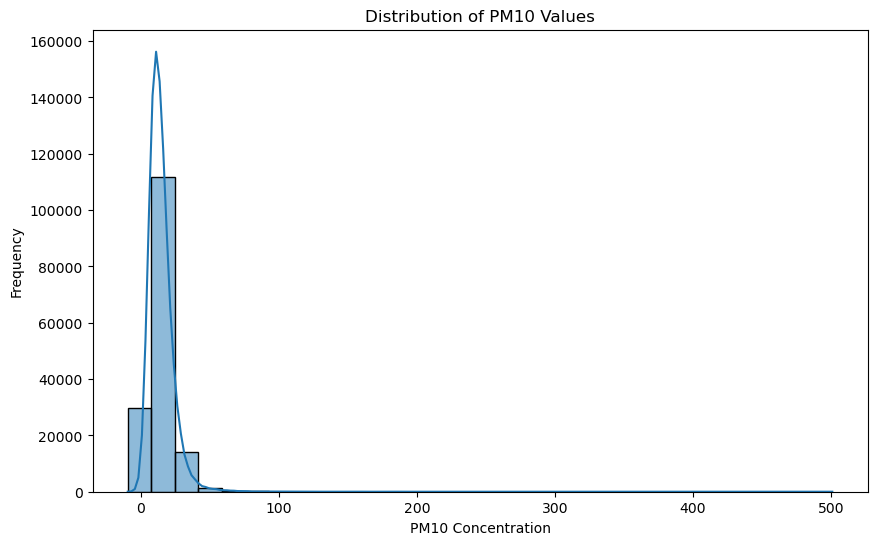

In [5]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming your CSV file is named 'pm10_data.csv' and is in the current working directory
df = pd.read_csv('pm10_data.csv')

# Histogram
plt.figure(figsize=(10, 6))
sns.histplot(df['Value'], bins=30, kde=True)  # Ensuring df is defined and used in the same scope
plt.title('Distribution of PM10 Values')
plt.xlabel('PM10 Concentration')
plt.ylabel('Frequency')
plt.show()
